# First checkpoint

In [1]:
# PATH = "drive/MyDrive/mgr/diffusion/result_path_jupyter/shared"
PATH = ".." # local
# DATA_DIR = "result_path_jupyter/data"
DATA_DIR = "data" # local

In [2]:

# from google.colab import drive
# drive.mount('/content/drive/')

In [3]:
# !ls $PATH/result_path_jupyter/data

In [4]:
# !pip install diffusers transformers accelerate datasets

In [5]:
import os

import matplotlib.pyplot as plt
import pandas as pd
import torch
import torchvision.transforms as transforms
from datasets import load_dataset
from diffusers import StableDiffusionPipeline
from PIL import Image
from torch.utils.data import DataLoader
from torchmetrics.image.fid import FrechetInceptionDistance
from tqdm import tqdm
from PIL import Image
import requests

## Save samples

In [6]:
def save_img(start_id: int, imgs: list[Image.Image], dir: str):
    for i, img in enumerate(imgs):
        path = os.path.join(PATH, DATA_DIR, dir, f"{i+start_id}.png")
        img.save(path)


def generate_images(
    model: StableDiffusionPipeline, ds, batch_size=16, start=0, dir="gen_1"
):
    for i in tqdm(range(start, ds.num_rows, batch_size)):
        prompts = ds["caption"][i : i + batch_size]
        imgs = model(prompt=prompts).images
        save_img(i, imgs, dir)

In [7]:
def to_tensor(examples):
    examples["image"] = [transform(image.convert("RGB")) for image in examples["image"]]
    return examples

# ds = load_dataset("mprzymus/text2tile_large")
# ds.set_transform(to_tensor)

# transform = transforms.Compose([transforms.ToTensor()])
# dl = DataLoader(ds["image"], batch_size=64)
# dl.batch_size

In [8]:
def count_fidelity(dir: str, dataloader: DataLoader):
    path = os.path.join(PATH, DATA_DIR, dir)
    fid = FrechetInceptionDistance(normalize=True)
    for i, imgs in enumerate(tqdm(dataloader)):
        gen_imgs = []
        for j in range(imgs.shape[0]):
            img_number = dl.batch_size * i + j
            img_path = os.path.join(path, f"{img_number}.png")
            gen_imgs.append(transform(Image.open(img_path)))
        gen_imgs = torch.stack(gen_imgs)
        fid.update(imgs, real=True)
        fid.update(gen_imgs, real=False)
    return fid.compute()

In [9]:

# count_fidelity("gen_2", dl)

In [10]:
# count_fidelity("gen_1", dl)

# City comparison

In [11]:
!mkdir ../results_lora/

mkdir: cannot create directory ‘../results_lora/’: File exists


In [12]:
prompts = [
    "6 building retails , 37 building residentials , 14 buildings , 7 highway services , 1 landuse religious.",
    "3 highway footways , 3 amenity parking spaces , 3 building apartmentss , 12 buildings , 1 building school.",
    "1 waterway stream, 1 sport swimming, 3 highway cycleways , 3 leisure pitchs , 7 amenity parkings .",
    "2 leisure playgrounds , 12 highway living streets , 1 amenity school, 4 highway tracks , 2 amenity benchs .",
    "1 building apartments, 2 highway footways , 15 highway residentials , 157 buildings , 1 amenity bench."
]

In [13]:
model_path = "mprzymus/map_diffusion_lora"
pipe = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, safety_checker=None)
pipe.unet.load_attn_procs(model_path)
pipe = pipe.to("cuda")

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


In [14]:
from functional import seq

def generate_samples_for_prompts(dir="../results_lora/"):
    exists = os.listdir(dir)
    with open("../data/cities.txt", "r") as cities_file:
        for city in tqdm(cities_file):
            city = city.replace("\n", "")
            if city in exists:
                continue
            for i in range(2):
                geocode = pd.read_json(
                    f"../data/tiles_own/{city}/metadata.jsonl", lines=True, nrows=1
                )
                geocode = geocode["geocode"].item()
                city_prompt = (
                    seq(prompts)
                    .map(lambda x: f"OSM from {geocode} of city area containing: {x}")
                    .to_list()
                )
                images = pipe(prompt=city_prompt, num_images_per_prompt=1).images
                for p, img in zip(city_prompt, images):
                    city_path = os.path.join(dir, city)
                    os.makedirs(city_path, exist_ok=True)
                    img.save(f"{city_path}/{p}_{i}.png")
                    del img

In [15]:
def compare_area_types(prompt_template, to_put):
    for area_type in to_put:
        imgs = pipe(prompt=prompt_template.format(area_type=area_type), num_images_per_prompt=4, height=256, width=256).images
        fig = plt.figure(figsize=(15, 7))

        for i in range(len(imgs)):
            fig.add_subplot(1, len(imgs), i+1)
            plt.imshow(imgs[i])
            plt.axis('off')
        fig.suptitle(area_type.upper(), fontsize=30)
        plt.show()

# Data examples

In [16]:
from srai.regionizers import SlippyMapRegionizer

def get_data(long, lat):
    x, y = SlippyMapRegionizer(zoom=16)._coordinates_to_x_y(long, lat)
    return f"{x}_{y}_16", f"https://www.openstreetmap.org/#map=16/{long}/{lat}", f"https://tile.openstreetmap.de/16/{x}/{y}.png"

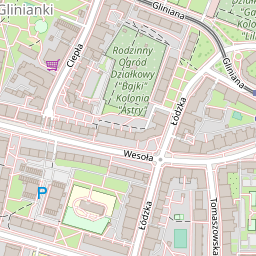

('35869_21913_16',
 'https://www.openstreetmap.org/#map=16/51.0899/17.0396',
 'https://tile.openstreetmap.de/16/35869/21913.png')

In [17]:
#huby
wroclaw = get_data(51.0899, 17.0396)
display(Image.open(requests.get(wroclaw[2], stream=True).raw))
wroclaw

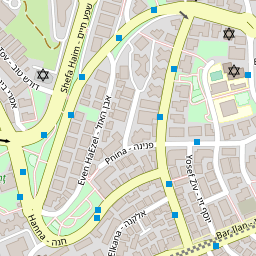

('39178_26657_16',
 'https://www.openstreetmap.org/#map=16/31.7946/35.2152',
 'https://tile.openstreetmap.de/16/39178/26657.png')

In [18]:
# na oko wszystko podobnie, jeruzalem jest ciekawe
jerusalem = get_data(31.7946, 35.2152)
display(Image.open(requests.get(jerusalem[2], stream=True).raw))
jerusalem

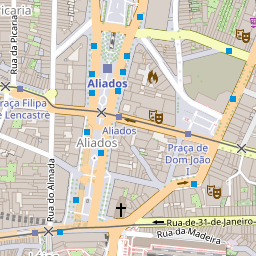

('31200_24535_16',
 'https://www.openstreetmap.org/#map=16/41.14785/-8.61118',
 'https://tile.openstreetmap.de/16/31200/24535.png')

In [19]:
# centrum miasta, porto jest ciekawym miastem ze względu na szerokie ulice
porto = get_data(41.14785, -8.61118)
display(Image.open(requests.get(porto[2], stream=True).raw))
porto

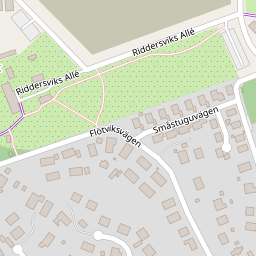

('36008_19255_16',
 'https://www.openstreetmap.org/#map=16/59.37955/17.7991',
 'https://tile.openstreetmap.de/16/36008/19255.png')

In [20]:
# obrzeża, plac zabaw
stockholm = get_data(59.37955, 17.79910)
display(Image.open(requests.get(stockholm[2], stream=True).raw))
stockholm

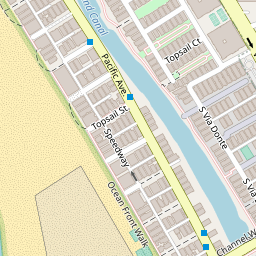

('11203_26186_16',
 'https://www.openstreetmap.org/#map=16/33.9677/-118.4557',
 'https://tile.openstreetmap.de/16/11203/26186.png')

In [21]:
# nadbrzeże
la = get_data(33.9677, -118.4557)
display(Image.open(requests.get(la[2], stream=True).raw))
la

In [22]:
from map_generation.osm_dataset import create_sentence
import pandas as pd

def get_sentence(city: str, img_id, replace_city_with=None):
    df = pd.read_json(f"../data/tiles_own/{city}/metadata.jsonl", lines=True)
    item = df[df["file_name"] == f"{img_id}.png"].squeeze()
    string = create_sentence(item, n_columns=10)
    city = item["geocode"]
    if replace_city_with is not None:
        string = string.replace(city, replace_city_with)
    return string

def get_city_name(city: str):
    df = pd.read_json(f"../data/tiles_own/{city}/metadata.jsonl", lines=True)
    item = df.iloc[0]
    city = item["geocode"]
    return city

In [23]:
to_replace = "{area_type}"
sentences = [
    get_sentence("Wrocław, PL", wroclaw[0], to_replace),
    get_sentence("Jerusalem, Izrael", jerusalem[0], to_replace),
    get_sentence("Porto, Portugal", porto[0], to_replace),
    get_sentence("Stockholm, Sweden", stockholm[0], to_replace),
    get_sentence("Los Angeles, USA", la[0], to_replace),
]
cities = [
    get_city_name("Wrocław, PL"),
    get_city_name("Jerusalem, Izrael"),
    get_city_name("Porto, Portugal"),
    get_city_name("Stockholm, Sweden"),
    get_city_name("Los Angeles, USA"),
    
]

sentences


['OSM from {area_type} of suburb area containing: 170 buildings , 1 highway mini roundabout, 1 building shed, 5 highway unclassifieds , 1 natural sand, 173 highway footways , 19 building garages , 3 amenity recyclings , 1 amenity post office, 76 highway services .',
 'OSM from {area_type} of city area containing: 6 amenity schools , 16 highway bus stops , 1 leisure pitch, 2 highway constructions , 10 leisure parks , 1 landuse meadow, 8 highway traffic signalss , 5 amenity place of worships , 1 landuse residential, 54 highway tertiarys .',
 'OSM from {area_type} of suburb area containing: 17 highway services , 28 leisure gardens , 3 office lawyers , 13 shop vacants , 1 shop wine, 6 amenity telephones , 4 amenity nightclubs , 61 amenity restaurants , 8 amenity waste disposals , 2 shop tobaccos .',
 'OSM from {area_type} of suburb area containing: 7 highway services , 8 highway residentials , 17 buildings , 1 amenity events venue, 63 building houses , 3 amenity parkings , 3 highway turnin

OSM from {area_type} of suburb area containing: 170 buildings , 1 highway mini roundabout, 1 building shed, 5 highway unclassifieds , 1 natural sand, 173 highway footways , 19 building garages , 3 amenity recyclings , 1 amenity post office, 76 highway services .


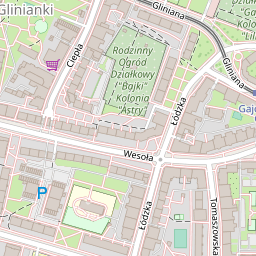

  0%|          | 0/50 [00:00<?, ?it/s]

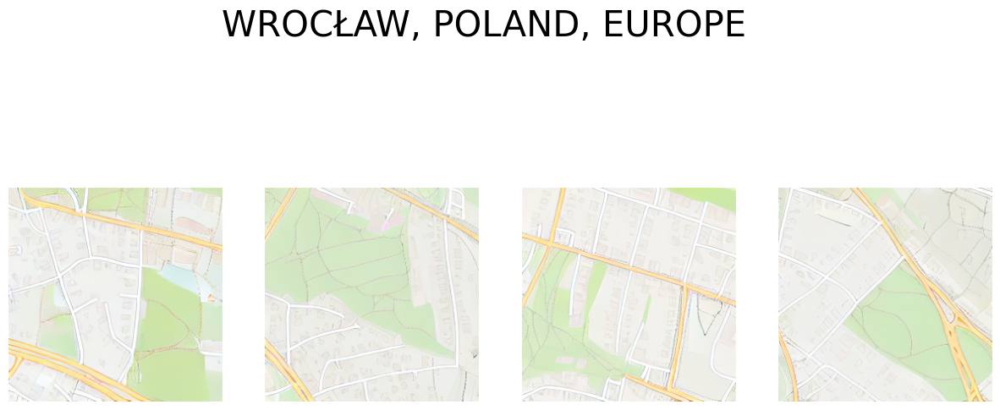

  0%|          | 0/50 [00:00<?, ?it/s]

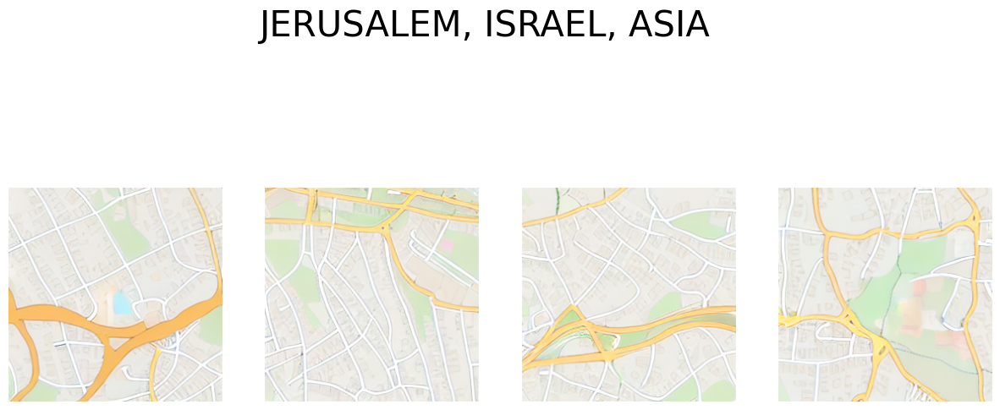

  0%|          | 0/50 [00:00<?, ?it/s]

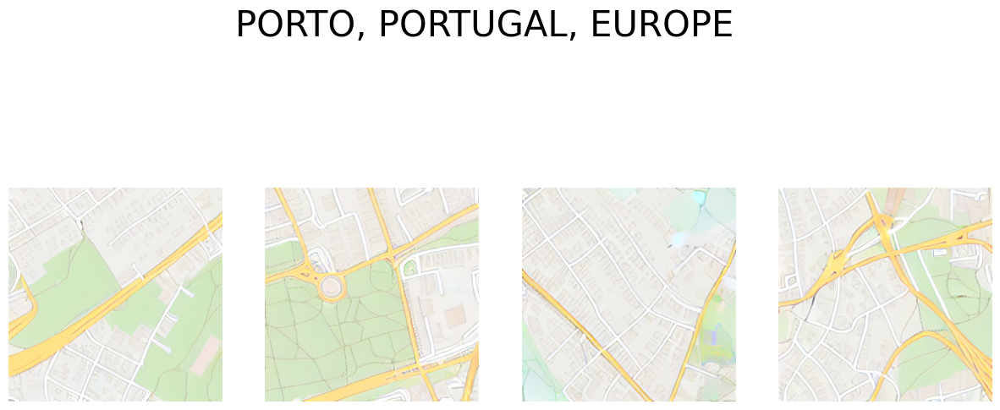

  0%|          | 0/50 [00:00<?, ?it/s]

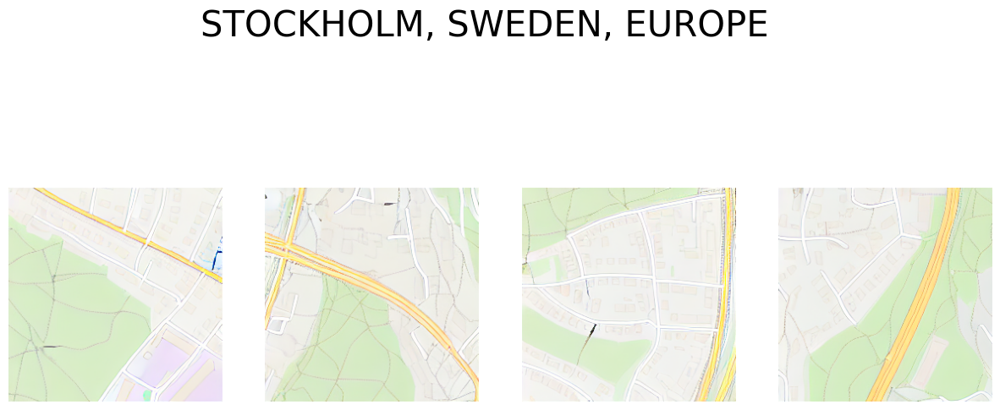

  0%|          | 0/50 [00:00<?, ?it/s]

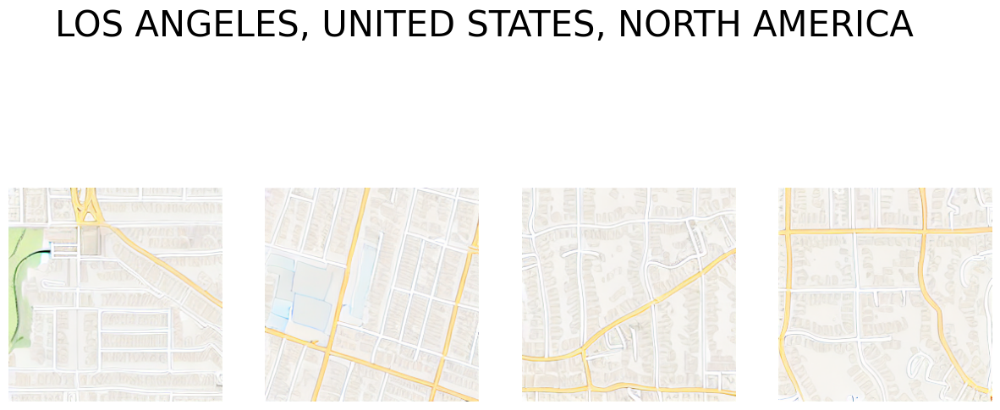

In [24]:
print(sentences[0])
display(Image.open(requests.get(wroclaw[2], stream=True).raw))
compare_area_types(sentences[0], cities)

OSM from {area_type} of city area containing: 6 amenity schools , 16 highway bus stops , 1 leisure pitch, 2 highway constructions , 10 leisure parks , 1 landuse meadow, 8 highway traffic signalss , 5 amenity place of worships , 1 landuse residential, 54 highway tertiarys .


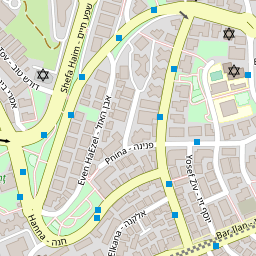

  0%|          | 0/50 [00:00<?, ?it/s]

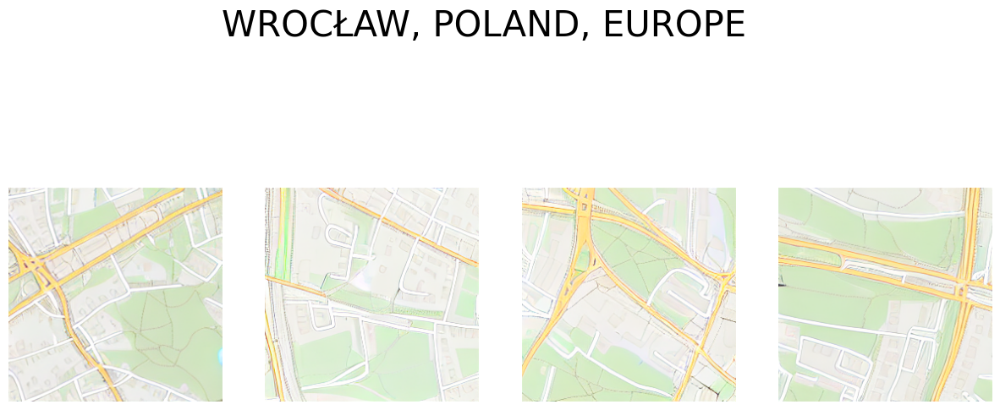

  0%|          | 0/50 [00:00<?, ?it/s]

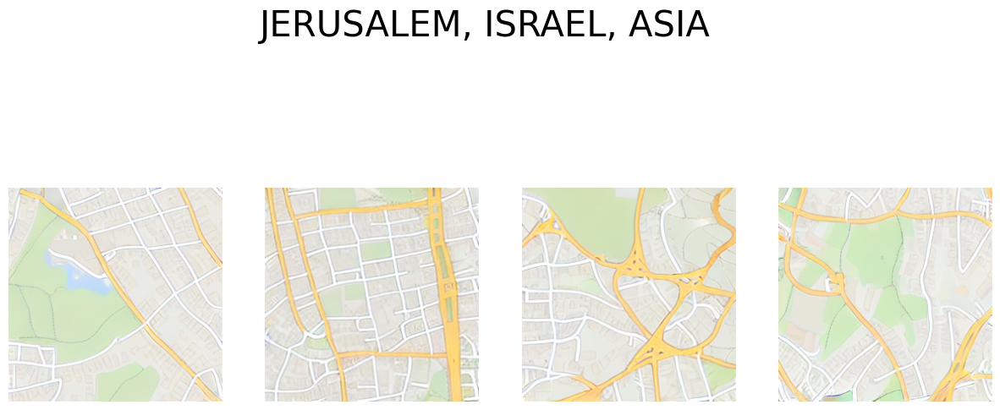

  0%|          | 0/50 [00:00<?, ?it/s]

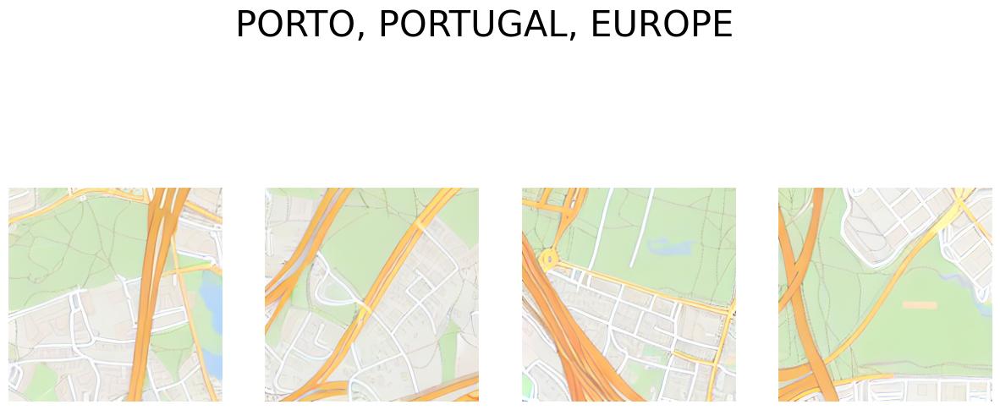

  0%|          | 0/50 [00:00<?, ?it/s]

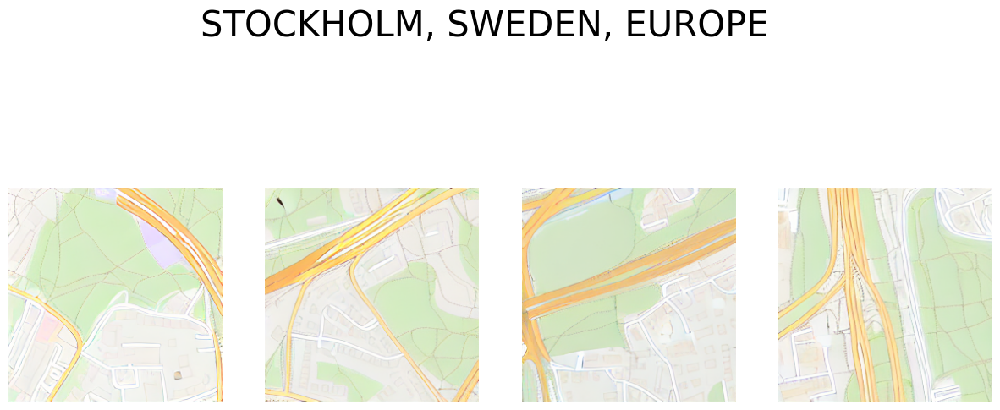

  0%|          | 0/50 [00:00<?, ?it/s]

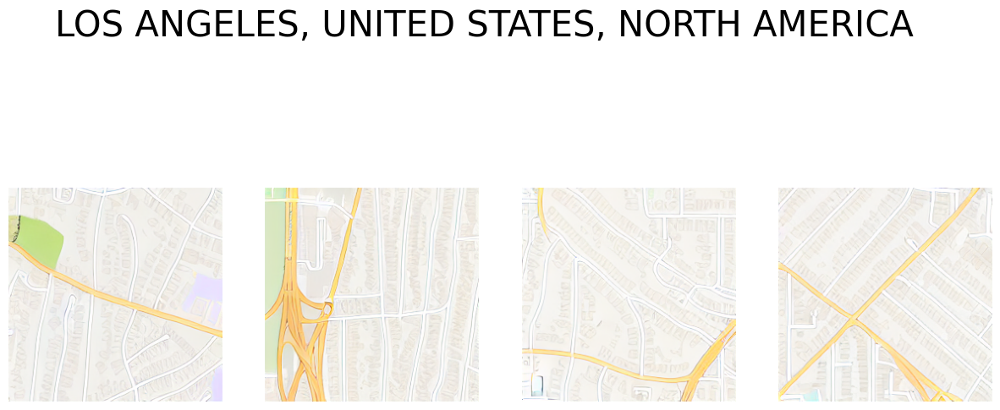

In [25]:
print(sentences[1])
display(Image.open(requests.get(jerusalem[2], stream=True).raw))
compare_area_types(sentences[1], cities)

OSM from {area_type} of suburb area containing: 17 highway services , 28 leisure gardens , 3 office lawyers , 13 shop vacants , 1 shop wine, 6 amenity telephones , 4 amenity nightclubs , 61 amenity restaurants , 8 amenity waste disposals , 2 shop tobaccos .


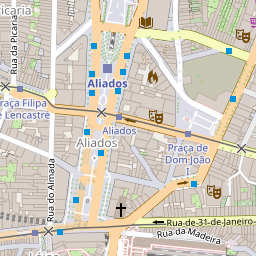

  0%|          | 0/50 [00:00<?, ?it/s]

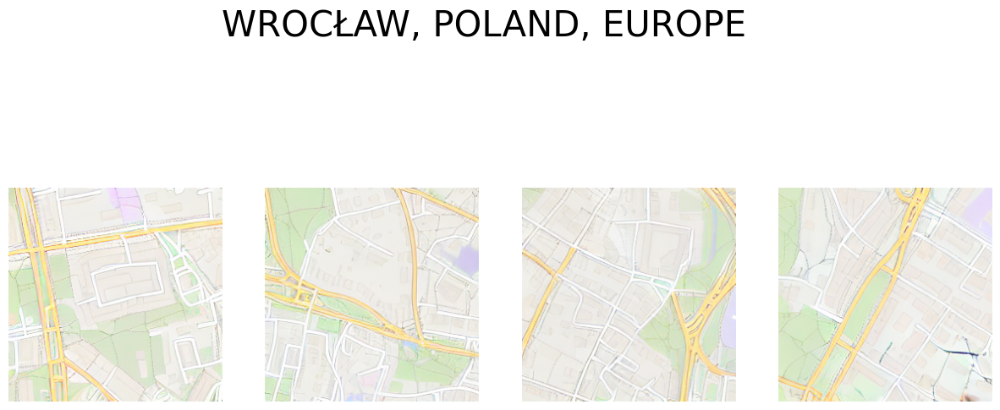

  0%|          | 0/50 [00:00<?, ?it/s]

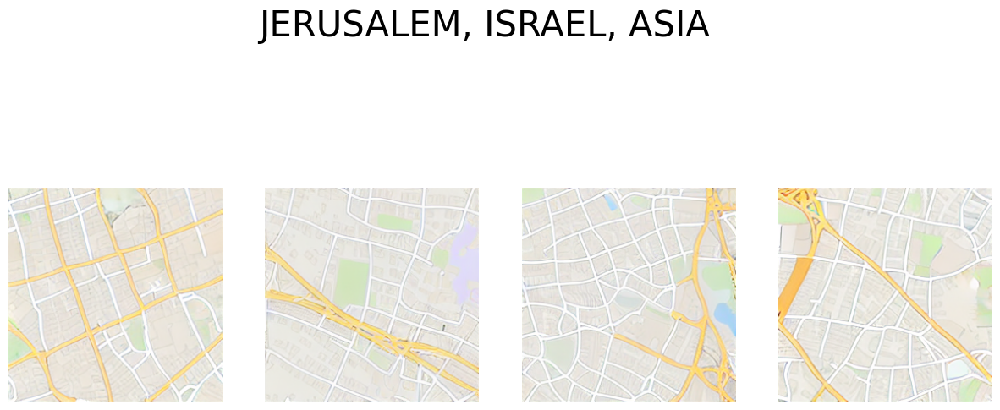

  0%|          | 0/50 [00:00<?, ?it/s]

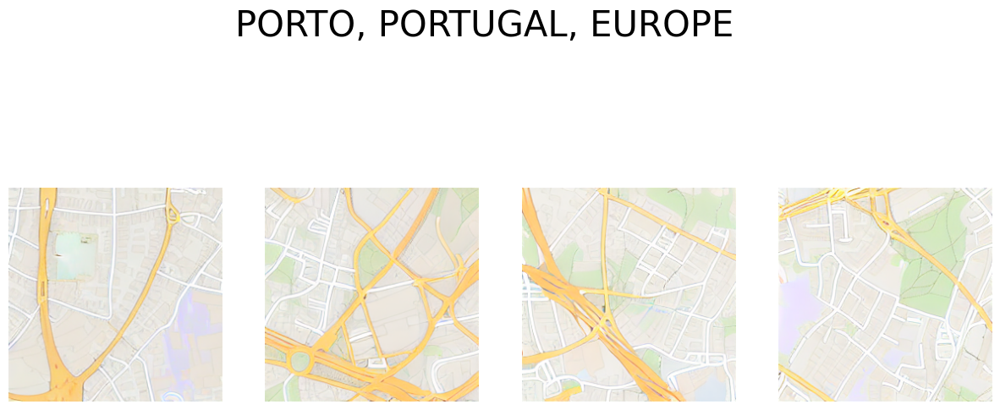

  0%|          | 0/50 [00:00<?, ?it/s]

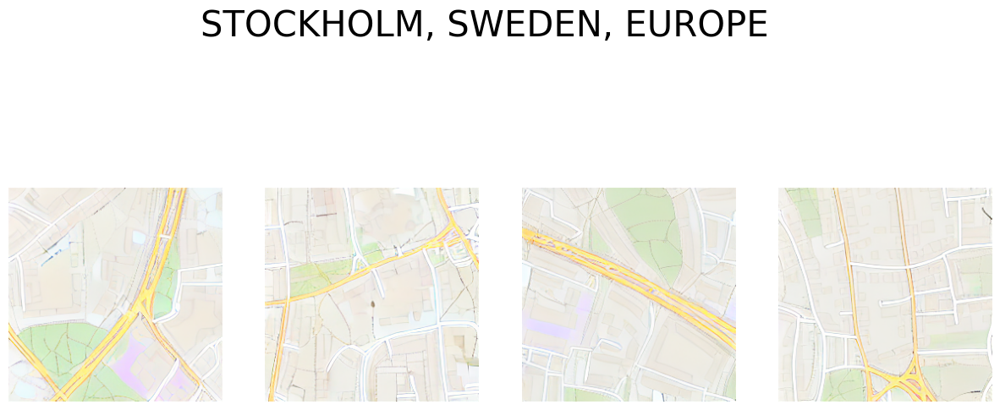

  0%|          | 0/50 [00:00<?, ?it/s]

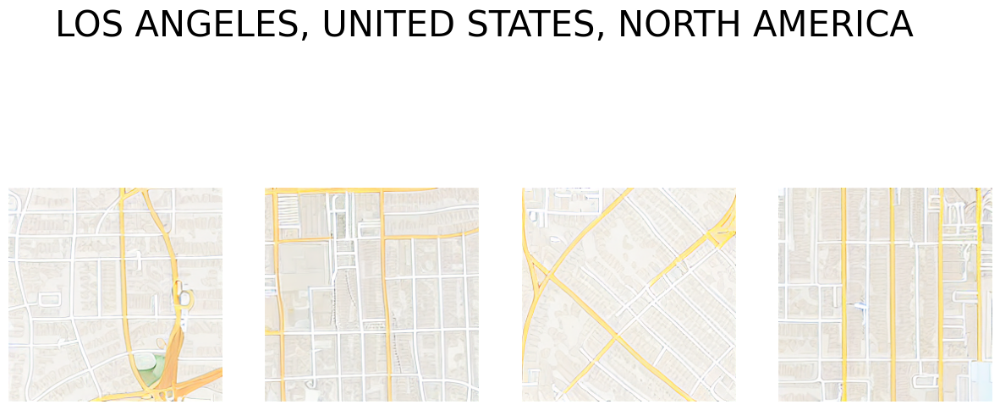

In [26]:
print(sentences[2])
display(Image.open(requests.get(porto[2], stream=True).raw))
compare_area_types(sentences[2], cities)

OSM from {area_type} of suburb area containing: 7 highway services , 8 highway residentials , 17 buildings , 1 amenity events venue, 63 building houses , 3 amenity parkings , 3 highway turning circles , 11 building sheds , 1 leisure garden, 3 landuse forests .


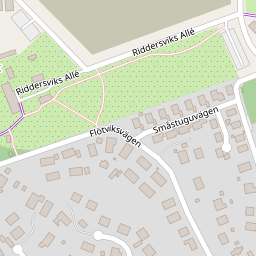

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


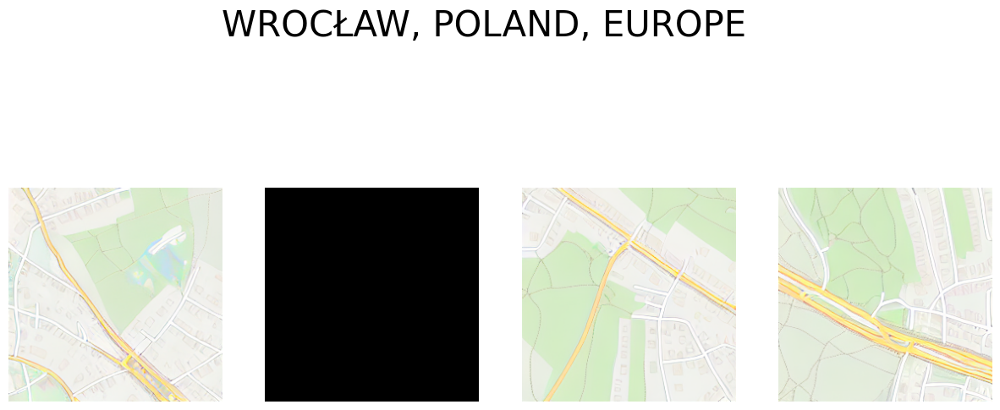

  0%|          | 0/50 [00:00<?, ?it/s]

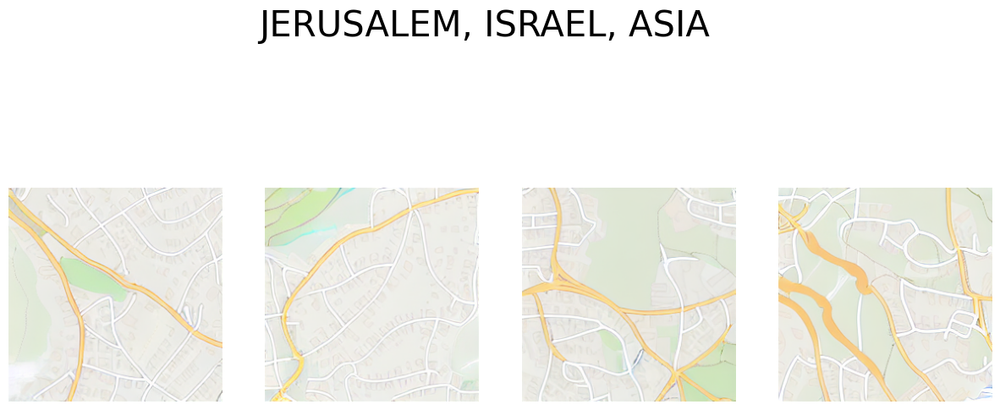

  0%|          | 0/50 [00:00<?, ?it/s]

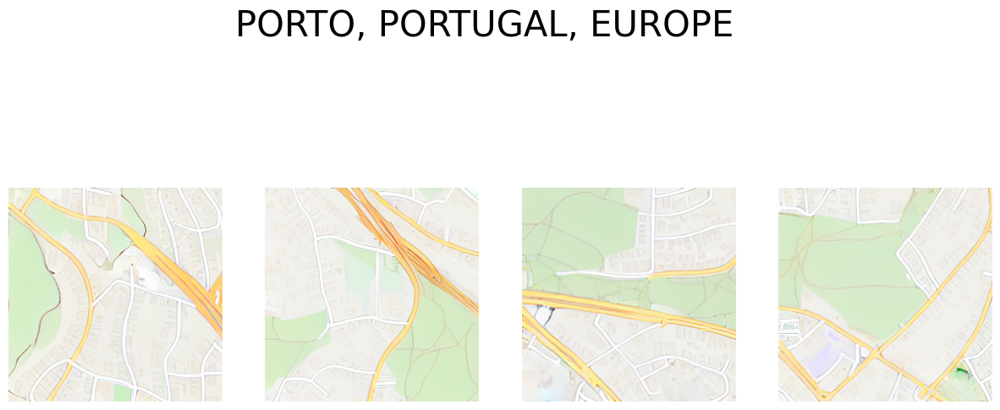

  0%|          | 0/50 [00:00<?, ?it/s]

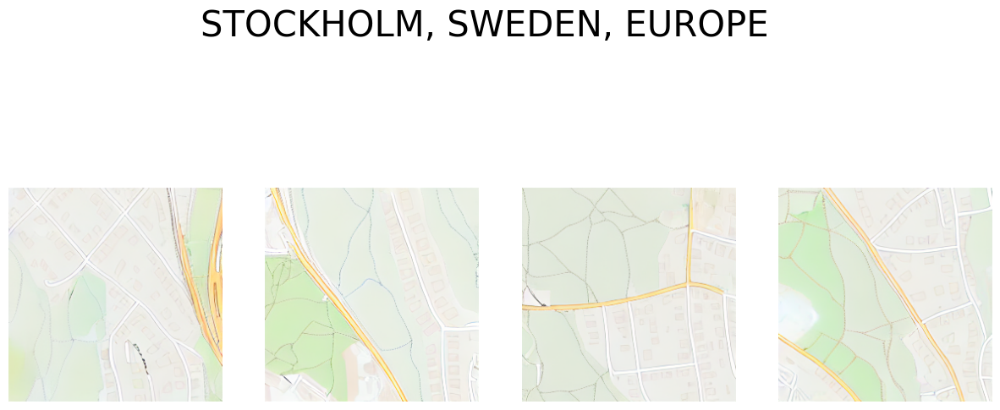

  0%|          | 0/50 [00:00<?, ?it/s]

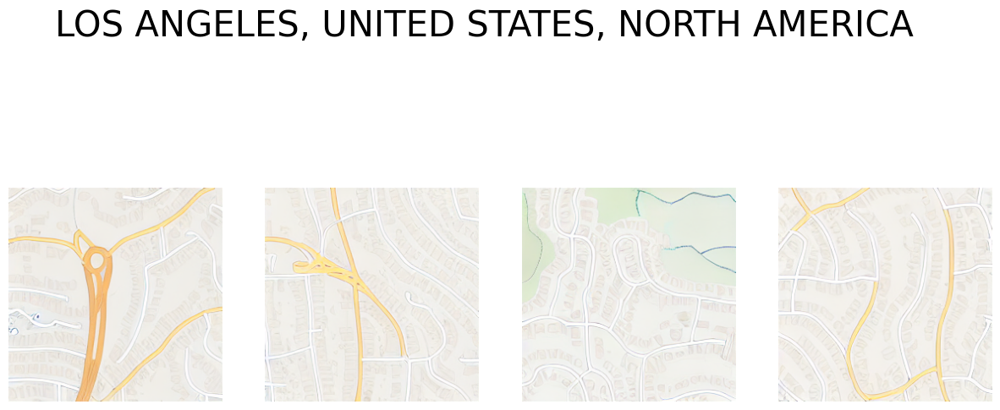

In [27]:
print(sentences[3])
display(Image.open(requests.get(stockholm[2], stream=True).raw))
compare_area_types(sentences[3], cities)

OSM from {area_type} of area containing: 3 highway pedestrians , 3 highway stops , 1 landuse residential, 4 highway bus stops , 4 leisure parks , 18 building apartmentss , 1 leisure marina, 1 natural sand, 2 sport tenniss , 6 highway tertiarys .


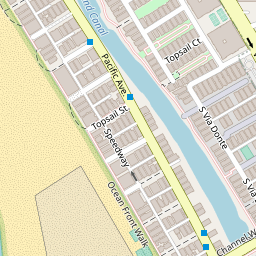

  0%|          | 0/50 [00:00<?, ?it/s]

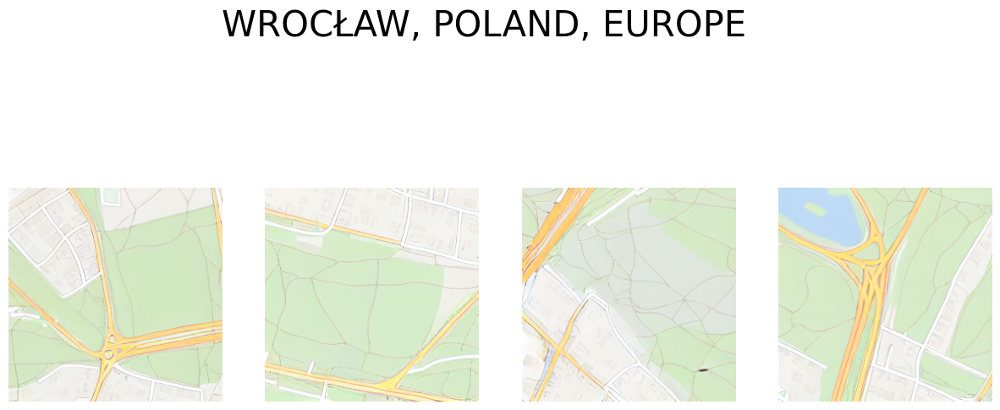

  0%|          | 0/50 [00:00<?, ?it/s]

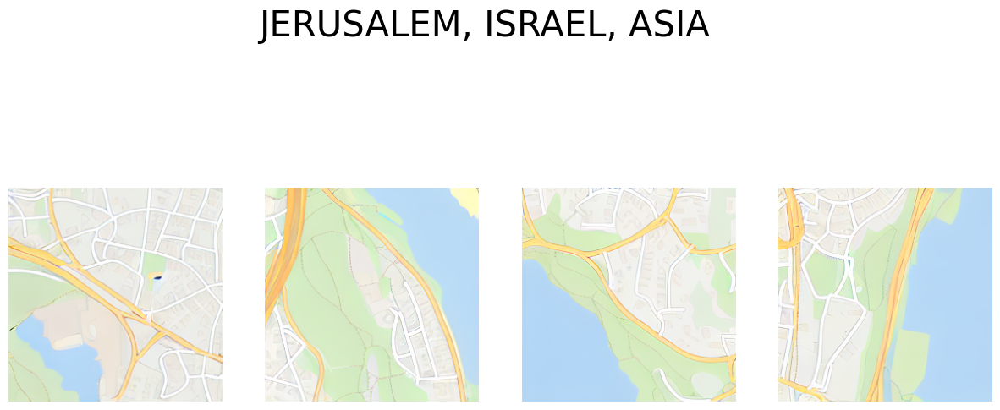

  0%|          | 0/50 [00:00<?, ?it/s]

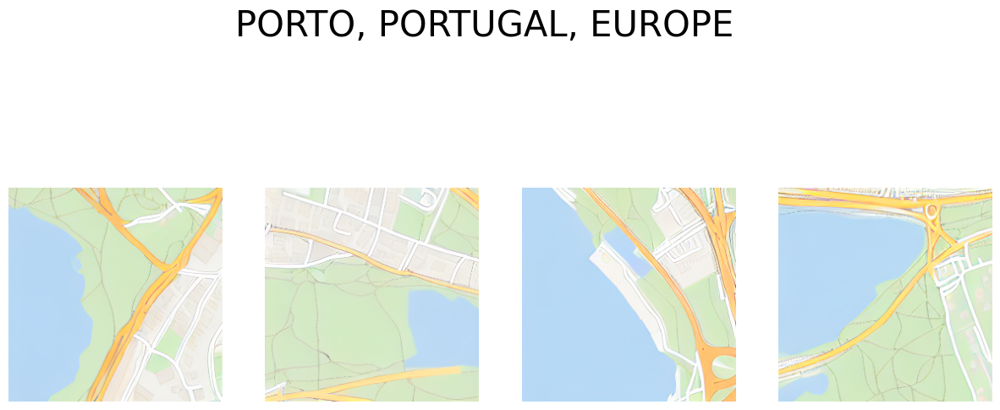

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


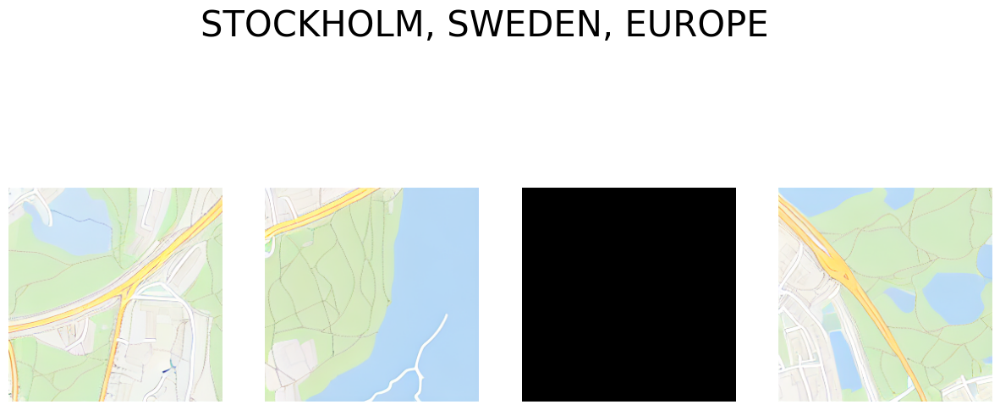

  0%|          | 0/50 [00:00<?, ?it/s]

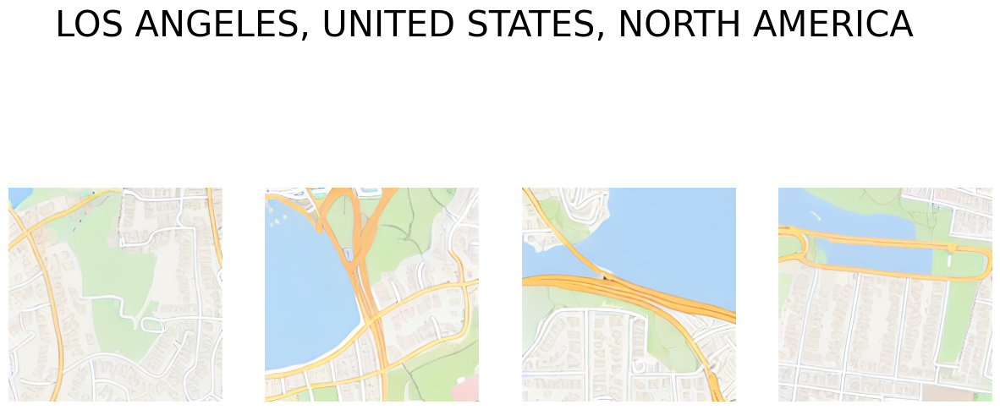

In [28]:
print(sentences[4])
display(Image.open(requests.get(la[2], stream=True).raw))
compare_area_types(sentences[4], cities)

OSM from {area_type} of suburb area containing: 1 landuse brownfield,  8 highway , 11 building sheds , 5 highway footways , 2 amenity parking spaces , 1 leisure playground, 7 highway services , 3 landuse forests .


  0%|          | 0/50 [00:00<?, ?it/s]

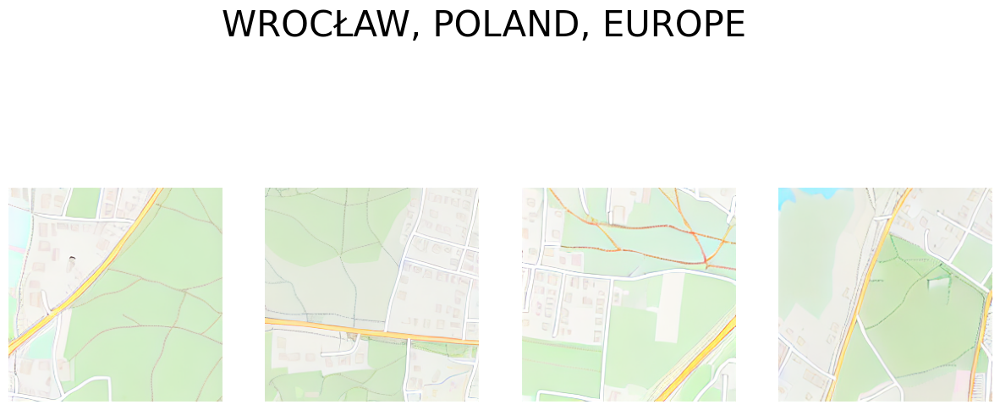

  0%|          | 0/50 [00:00<?, ?it/s]

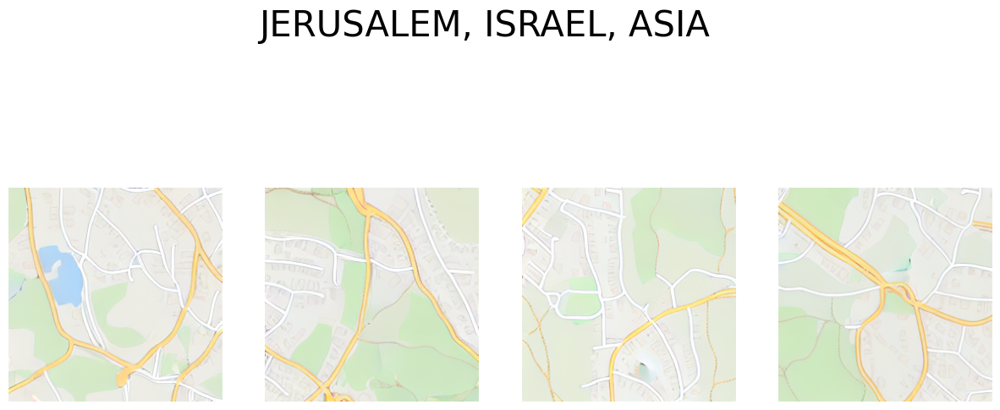

  0%|          | 0/50 [00:00<?, ?it/s]

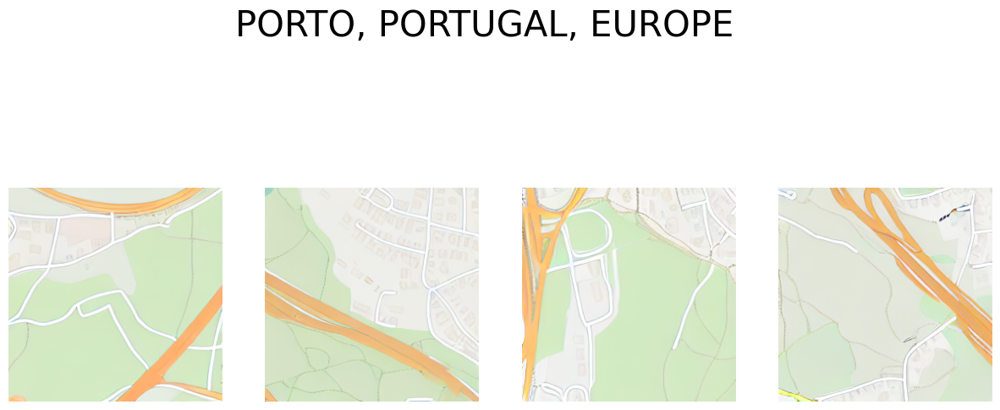

  0%|          | 0/50 [00:00<?, ?it/s]

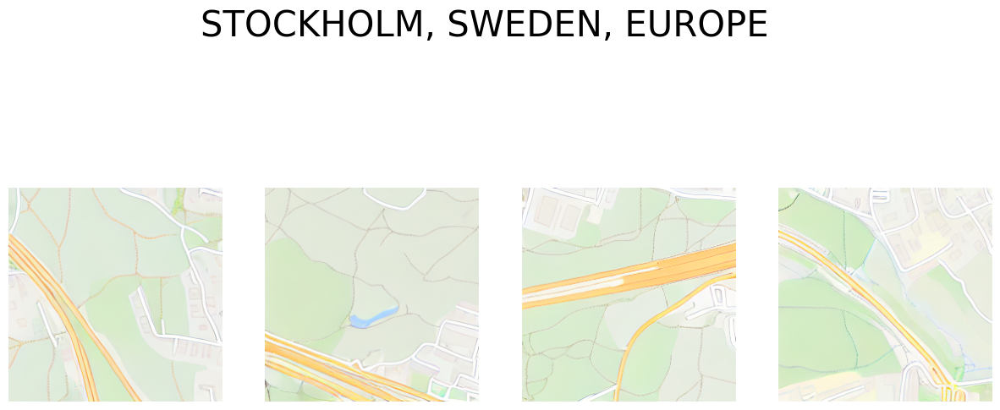

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


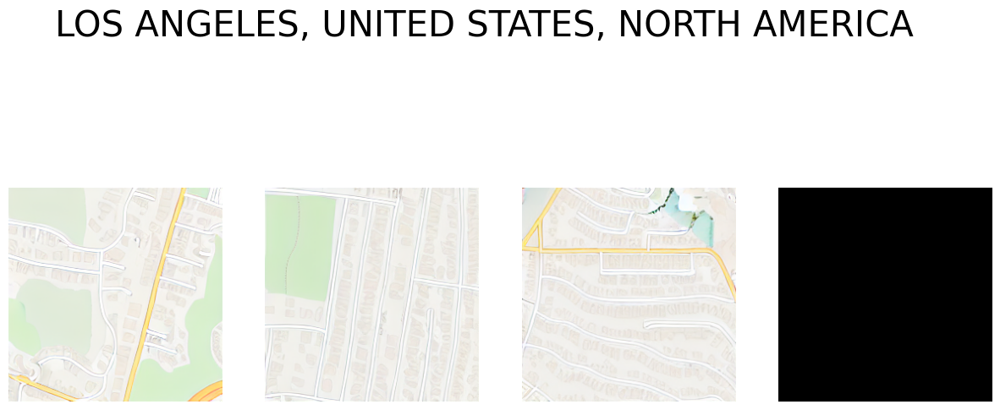

In [29]:
prompt = "OSM from {area_type} of suburb area containing: 1 landuse brownfield,  8 highway , 11 building sheds , 5 highway footways , 2 amenity parking spaces , 1 leisure playground, 7 highway services , 3 landuse forests ."
print(prompt)
compare_area_types(prompt, cities)

# Miksowanie typu miejsca

  0%|          | 0/50 [00:00<?, ?it/s]

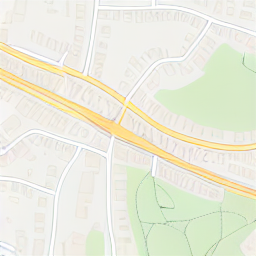

In [30]:
pipe(prompt=sentences[0].format(area_type="Los Angeles, Denmark, Europe"), width=256, height=256).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

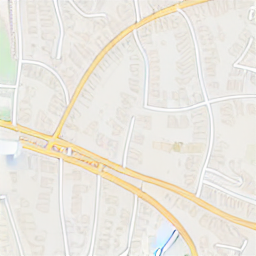

In [31]:
pipe(prompt=sentences[0].format(area_type="Los Angeles, USA, Europe"), width=256, height=256).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

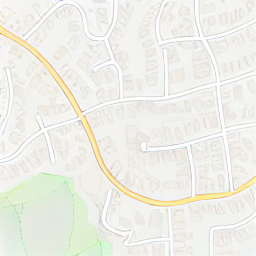

In [32]:
pipe(prompt=sentences[0].format(area_type="Los Angeles, USA, North America"), width=256, height=256).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

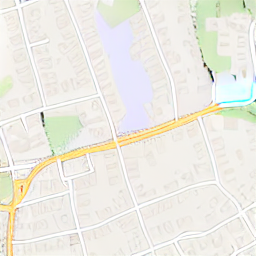

In [33]:
pipe(prompt=sentences[0].format(area_type="Los Angeles, Poland, Europe"), width=256, height=256).images[0]

# Area types

In [34]:
cities_dict = {}
def read_city(admin):
    df = pd.read_pickle(f"../data/admins/{admin}")
    return df.groupby("name").count()["admin_region"]

for admin in os.listdir("../data/admins/"):
    df = read_city(admin)
    cities_dict[admin] = df.shape[0]
    


In [35]:
data = pd.Series(data=cities_dict)
data[data == data.max()].index.item()

'Kraków, PL.pkl'

In [36]:
area_types = read_city(data[data == data.max()].index.item()).index
area_types

Index(['city', 'city_block', 'hamlet', 'locality', 'neighbourhood', 'quarter',
       'suburb', 'town', 'unknown', 'village'],
      dtype='object', name='name')

  0%|          | 0/50 [00:00<?, ?it/s]

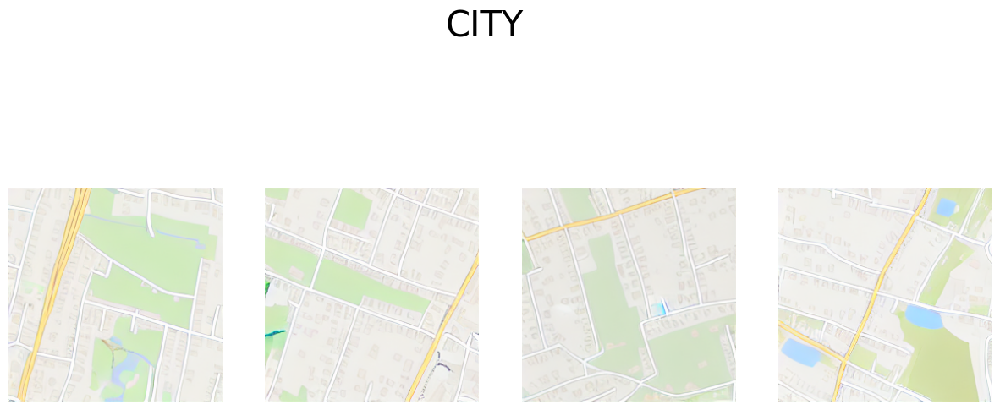

  0%|          | 0/50 [00:00<?, ?it/s]

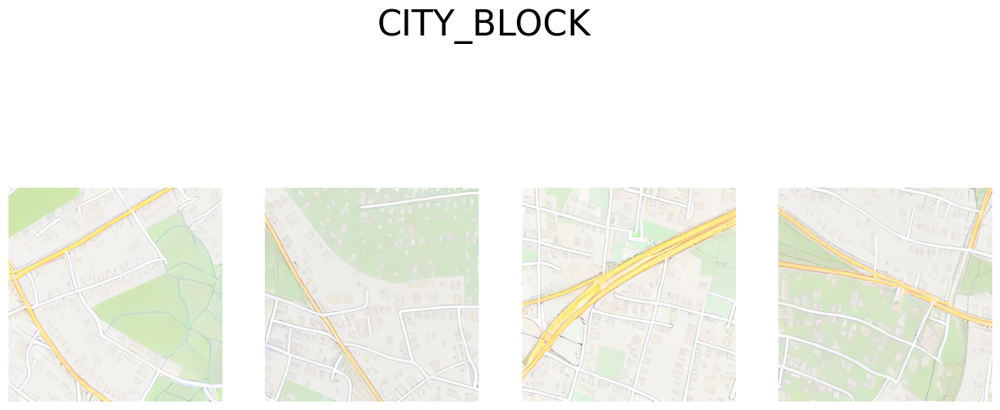

  0%|          | 0/50 [00:00<?, ?it/s]

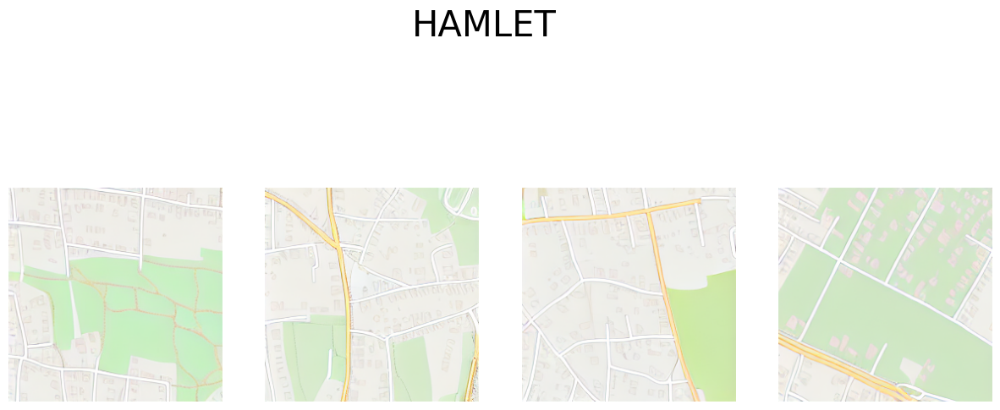

  0%|          | 0/50 [00:00<?, ?it/s]

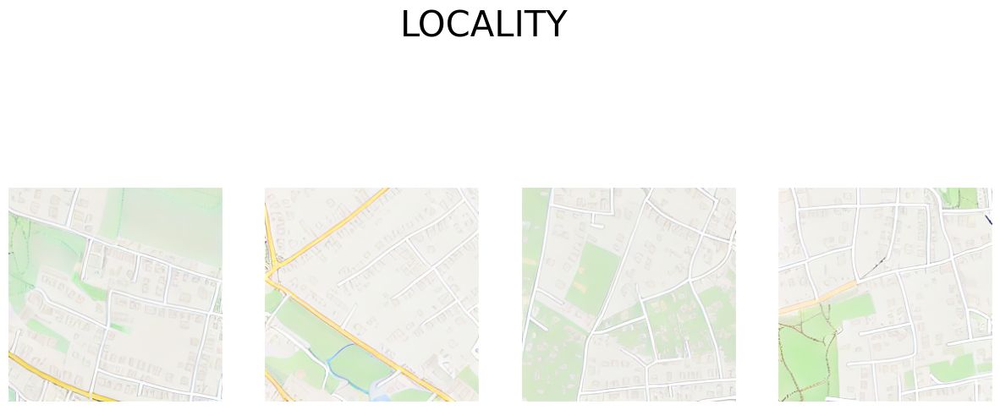

  0%|          | 0/50 [00:00<?, ?it/s]

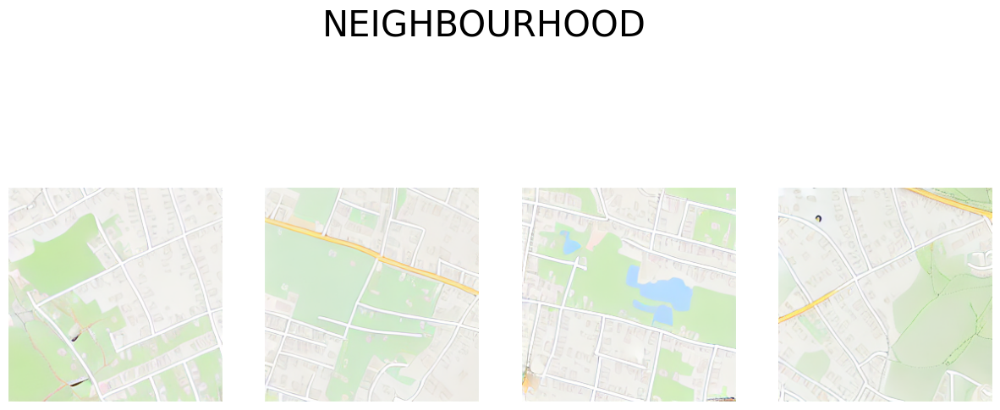

  0%|          | 0/50 [00:00<?, ?it/s]

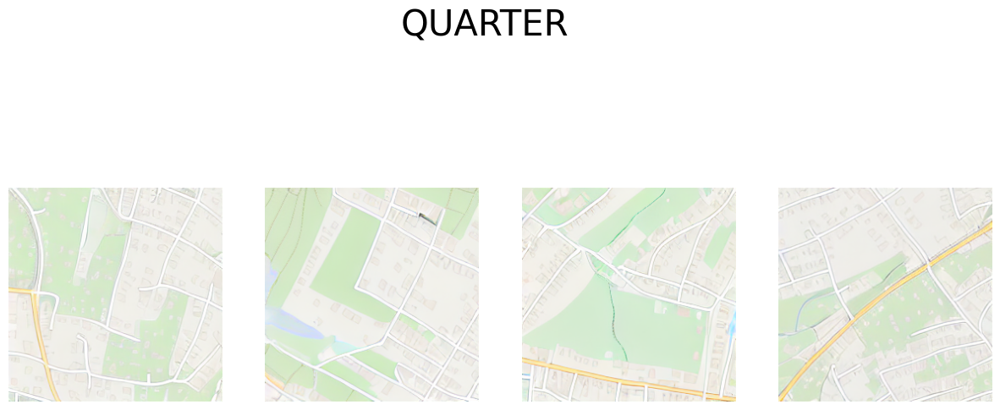

  0%|          | 0/50 [00:00<?, ?it/s]

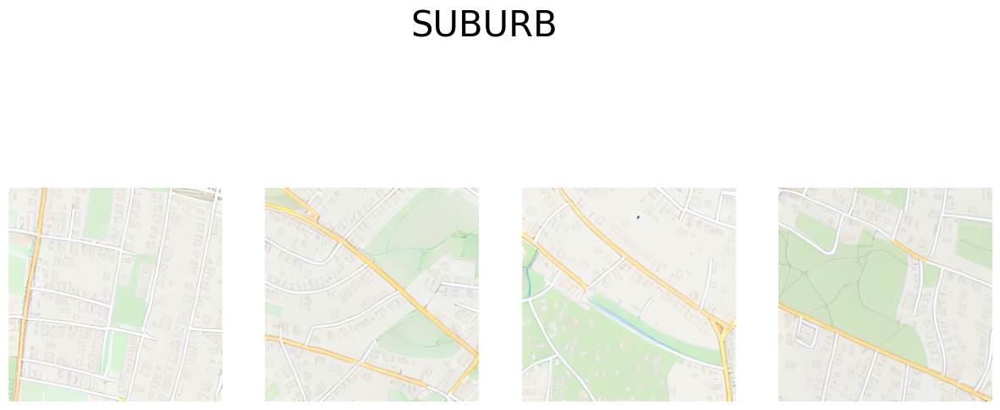

  0%|          | 0/50 [00:00<?, ?it/s]

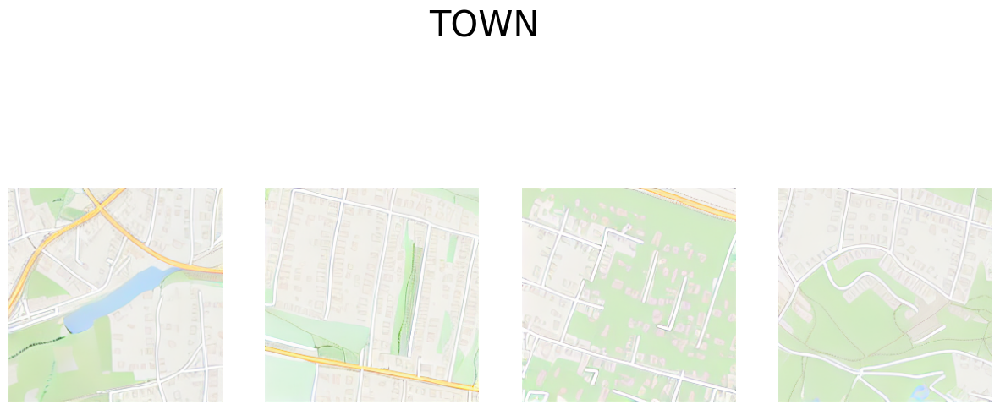

  0%|          | 0/50 [00:00<?, ?it/s]

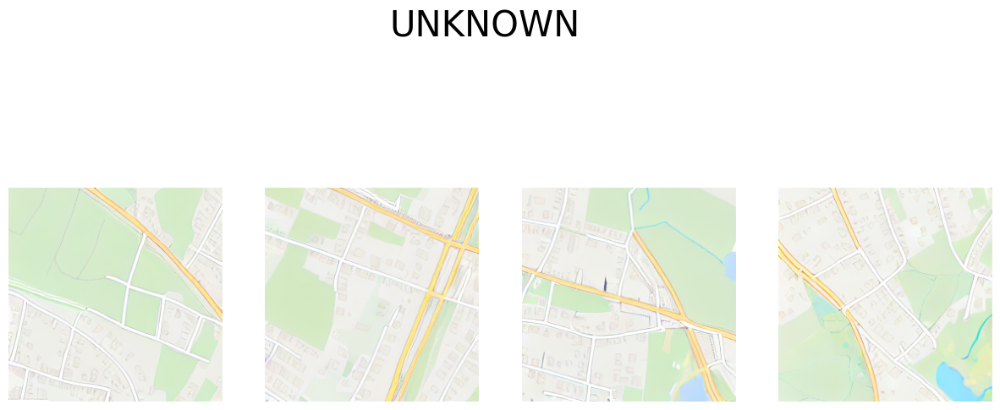

  0%|          | 0/50 [00:00<?, ?it/s]

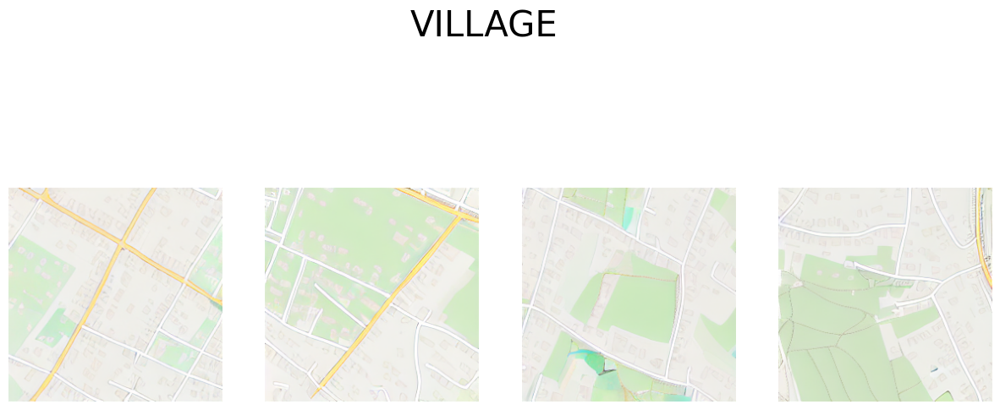

In [37]:
prompt_template = "OSM from Wrocław, Poland, Europe of {area_type} area containing: 6 building retails , 37 building residentials , 14 buildings , 7 highway services , 1 landuse religious."

compare_area_types(prompt_template, to_put=area_types)